In [1]:
%cd ..

/home/prayson/Code/apartements


In [2]:
import pandas as pd
import numpy as np

In [3]:
df = pd.read_csv("assets/data/bolig.csv.gzip",
                 compression="gzip", 
                 parse_dates=["soldDate"])
df.sample(4)

,estateId,address,zipCode,price,soldDate,propertyType,saleType,sqmPrice,rooms,size,...,change,guid,latitude,longitude,municipalityCode,estateCode,city,groupKey,canGetVR,bfEnr
42832,1606647,"Meinungsgade 10, 2. th",2200,3520000,2019-11-06 23:00:00+00:00,3,Alm. Salg,46315.790,3.0,76,...,0.571429,798BBF39-91B0-4FB3-9708-0AFD7CDC1DE2,55.692130,12.554157,101,788911,København N,NaN,True,149053
60152,0,"Glasvej 25, 1. th",2400,2795000,2016-11-21 23:00:00+00:00,3,Alm. Salg,27673.268,3.0,101,...,0.000000,871DC670-9DE3-457A-B67F-43E6E8BA861B,55.704964,12.531240,101,28742,København NV,NaN,True,163384
48495,0,"Thyrasgade 4, 5. 614",2200,807500,2018-11-22 23:00:00+00:00,3,Fam. Salg,14419.643,2.0,56,...,0.000000,BDAC1646-4EDE-41AC-AD97-92054EBFD58A,55.697674,12.546089,101,877167,København N,2.0,True,144573
31772,1710316,"Midtermolen 16, 3. th",2100,5080000,2021-03-30 22:00:00+00:00,3,Alm. Salg,60476.190,2.0,84,...,1.701702,088B5856-F972-480C-977D-29F3B0002B05,55.697327,12.597718,101,28330,København Ø,NaN,True,104958


In [4]:
df.columns

Index(['estateId', 'address', 'zipCode', 'price', 'soldDate', 'propertyType',
       'saleType', 'sqmPrice', 'rooms', 'size', 'buildYear', 'change', 'guid',
       'latitude', 'longitude', 'municipalityCode', 'estateCode', 'city',
       'groupKey', 'canGetVR', 'bfEnr'],
      dtype='object')

In [5]:
LOWER_PRICE, HIGHER_PRICE = 500_000, 9_000_000
NUMBER_OF_ROOMS = 6
SALES_TYPE = 'Alm. Salg'

(df
     .loc[(df['saleType'].eq(SALES_TYPE)) &
           (df['price'].between(LOWER_PRICE, HIGHER_PRICE)) &
           (df['rooms'].lt(NUMBER_OF_ROOMS))
 ]
     .sort_values(by="soldDate")

).sample(5)

,estateId,address,zipCode,price,soldDate,propertyType,saleType,sqmPrice,rooms,size,...,change,guid,latitude,longitude,municipalityCode,estateCode,city,groupKey,canGetVR,bfEnr
42548,1579290,"Sommerstedgade 21, 2. th",1718,3150000,2019-11-25 23:00:00+00:00,3,Alm. Salg,43750.000,3.0,72,...,-5.829597,3DB71BEF-49CC-4D19-9475-766C3F545348,55.666120,12.556751,101,515591,København V,NaN,True,159845
32160,1756804,"Tåsingegade 47, 3. th",2100,4995000,2021-03-18 23:00:00+00:00,3,Alm. Salg,50969.387,3.0,98,...,0.000000,94DCF00A-DA3D-498E-99FE-AE18A72DC0D9,55.710213,12.566829,101,874435,København Ø,NaN,True,155217
80749,360261,"Tuborgvej 17, st. 5",2900,925000,2009-05-19 22:00:00+00:00,3,Alm. Salg,13405.797,2.0,69,...,-22.916668,07144C3C-4023-43EC-821C-60FC7725E9C0,55.726230,12.572700,101,874966,Hellerup,NaN,True,153987
29643,1791425,"Helga Larsens Plads 8, 4. mf",2720,2210000,2021-06-19 22:00:00+00:00,3,Alm. Salg,39464.285,2.0,56,...,-1.777778,2009C4CE-6ACD-4866-9DBE-BD57A1785389,55.684437,12.484073,101,284638,Vanløse,NaN,True,168280
11689,504057,"Kingosgade 11, 1. 87",1818,1290000,2010-10-31 23:00:00+00:00,3,Alm. Salg,22631.578,1.0,57,...,-4.444445,11B6BEDB-FA3F-4D32-9178-0AF394D85DDF,55.672390,12.544737,147,164297,Frederiksberg C,NaN,True,194146


In [6]:
#Sorting fam_salg away
SALES_TYPE = 'Alm. Salg'
#Sorting apartments away that where sold for under 500.000 and above 9.000.000
LOWER_PRICE, HIGHER_PRICE = 450_000, 9_500_000

#Sorting apartments away that have above 5 roomes doe to the likelyhood of it being under 0.001%procent
NUMBER_OF_ROOMS = 5


alm_salg_df = (df
     .loc[(df['saleType'].eq(SALES_TYPE)) &
           (df['price'].between(LOWER_PRICE, HIGHER_PRICE)) &
           (df['rooms'].le(NUMBER_OF_ROOMS))
 ]
    .assign(floor = lambda d: d["address"].str.extract(
        r',\s*(?P<floor>\d+|st)(?=\s*[a-z]*\.?\s|$)'
        ).replace("st", 0).fillna(0).astype(int))
        .sort_values(by="soldDate")
     
)

(alm_salg_df
  .sample(5)
  .loc[:, ["price", "rooms", "size", "soldDate"]]
  .assign(soldAge = lambda d: (d["soldDate"].dt.date - pd.to_datetime("1991-01-01")).dt.days/365)
  .loc[:,["price", "rooms", "size", "soldAge"]] 
)

In [7]:
alm_salg_df.columns

Index(['estateId', 'address', 'zipCode', 'price', 'soldDate', 'propertyType',
       'saleType', 'sqmPrice', 'rooms', 'size', 'buildYear', 'change', 'guid',
       'latitude', 'longitude', 'municipalityCode', 'estateCode', 'city',
       'groupKey', 'canGetVR', 'bfEnr', 'floor'],
      dtype='object')

In [8]:
features  =['address', 'zipCode', 'soldDate', 'rooms', 'floor', 'size', 'buildYear',
'latitude', 'longitude', 'municipalityCode', 'estateCode', 'city', 'price',]

alm_salg_df = alm_salg_df[features].astype({"rooms": np.int8, "size": np.int16, "buildYear": np.int32,
                              "municipalityCode": np.int32, "estateCode":np.int32,
                             "zipCode": np.int32})

In [9]:
import hiplot as hip

In [10]:
explore_data = alm_salg_df[features].astype({"rooms": np.int8, "size": np.int16, "buildYear": np.int32,
                              "municipalityCode": np.int32, "estateCode":np.int32,
                             "zipCode": np.int32})
explore_data = (explore_data
                    .assign(soldYear=lambda d: d["soldDate"].dt.year,
                            soldMonth=lambda d: d["soldDate"].dt.month,)
                    .drop(columns=["address", "soldDate"])
                  # after the viz, we discovered Build Year 0 and size 857?
                   .loc[lambda d: (d['buildYear'].ne(0) & d["size"].lt(350))]
                   )

In [11]:
#alm_salg_df.loc[lambda d: d["floor"].gt(24)]

In [12]:
explore_data.columns[::-1]

Index(['soldMonth', 'soldYear', 'price', 'city', 'estateCode',
       'municipalityCode', 'longitude', 'latitude', 'buildYear', 'size',
       'floor', 'rooms', 'zipCode'],
      dtype='object')

In [13]:
order_columns = ['price',   'size', 'rooms', 'floor', 'longitude', 'latitude', 
                 'buildYear','soldMonth', 'soldYear','zipCode' , 'city',]

In [14]:
viz = hip.Experiment.from_dataframe(explore_data[order_columns])

In [15]:
viz.display();  # soldMonth has no effect & interestubg suze of 857, I think the correct is 85.7

<IPython.core.display.Javascript object>

In [16]:
interesting_columns = ['price',   'size', 'rooms', 'floor', 'longitude', 'latitude', 
                 'buildYear', 'soldYear','zipCode' , 'city',]

In [17]:
from sklearn.model_selection import train_test_split

In [18]:
from sklearn.linear_model import LinearRegression
import patsy as ps

In [19]:
X = explore_data[[ 'size', 'rooms', 'longitude', 'latitude', 
                 'buildYear', 'floor', 'soldYear','zipCode' , 'city',]]
y = explore_data["price"]

In [20]:
y_, X_ = ps.dmatrices( "price ~ size + C(rooms) + C(buildYear) + C(soldYear) + latitude + longitude - 1", data=X.assign(price=y))

In [21]:
X_train, X_test, y_train, y_test = train_test_split(X_, y_, train_size=.9, stratify=X["floor"])

In [22]:
# price ~ (size + C(rooms) + C(soldYear))**2 + (latitude + longitude)**2  - 1"

In [23]:
# price ~ size

In [24]:
y_train, y_test = y_train.ravel(), y_test.ravel()

In [25]:
LinearRegression(n_jobs=-1).fit(X_train, y_train).score(X_test, y_test)

0.5475532178822771

In [26]:
from sklearn.neighbors import KNeighborsRegressor 

In [27]:
KNeighborsRegressor(n_jobs=-1, n_neighbors=7).fit(X_train, y_train).score(X_test, y_test)

0.5957918656711405

In [28]:
from sklearn.ensemble import GradientBoostingRegressor, ExtraTreesRegressor

In [29]:
GradientBoostingRegressor(learning_rate=0.7, n_estimators=107,).fit(X_train, y_train).score(X_test, y_test)

0.742379283814818

In [30]:
ExtraTreesRegressor(n_jobs=-1, n_estimators=107).fit(X_train, y_train).score(X_test, y_test)

0.8370902390243106

In [31]:
# AutoML do better?

In [32]:
from flaml import AutoML

In [33]:
automl = AutoML()

automl_settings = {
    "time_budget": 60*7,  # in seconds
    "metric": 'rmse',
    "task": 'regression',
    "log_file_name": "bolig.log",
    "estimator_list":  ['xgboost', 'xgb_limitdepth', 'lgbm','catboost', 'extra_tree',],
    "sample": True,
    "n_jobs": -1,
}

automl.fit(X_train=X_train, y_train=y_train, **automl_settings)

[flaml.automl.logger: 11-11 18:31:46] {1679} INFO - task = regression
[flaml.automl.logger: 11-11 18:31:46] {1690} INFO - Evaluation method: holdout
[flaml.automl.logger: 11-11 18:31:46] {1788} INFO - Minimizing error metric: rmse
[flaml.automl.logger: 11-11 18:31:46] {1900} INFO - List of ML learners in AutoML Run: ['xgboost', 'xgb_limitdepth', 'lgbm', 'catboost', 'extra_tree']
[flaml.automl.logger: 11-11 18:31:46] {2218} INFO - iteration 0, current learner xgboost
[flaml.automl.logger: 11-11 18:31:46] {2344} INFO - Estimated sufficient time budget=15810s. Estimated necessary time budget=83s.
[flaml.automl.logger: 11-11 18:31:46] {2391} INFO -  at 0.4s,	estimator xgboost's best error=1656867.2100,	best estimator xgboost's best error=1656867.2100
[flaml.automl.logger: 11-11 18:31:46] {2218} INFO - iteration 1, current learner lgbm
[flaml.automl.logger: 11-11 18:31:46] {2391} INFO -  at 0.4s,	estimator lgbm's best error=1656867.2374,	best estimator xgboost's best error=1656867.2100
[fla

In [34]:
automl.score(X_test, y_test)

0.88412873046344

In [35]:
automl.best_estimator, automl.best_config_per_estimator.get(automl.best_estimator)

('lgbm',
 {'n_estimators': 2337,
  'num_leaves': 267,
  'min_child_samples': 9,
  'learning_rate': 0.040464524134700836,
  'log_max_bin': 10,
  'colsample_bytree': 0.5805150806812911,
  'reg_alpha': 0.023296498194689437,
  'reg_lambda': 0.01198109649328531})

In [36]:
from autogluon.tabular import TabularPredictor, TabularDataset

In [37]:
train_data_ = TabularDataset(pd.DataFrame(X_train, columns=X_.design_info.column_names).assign(price=y_train))
test_data_ = TabularDataset(pd.DataFrame(X_test, columns=X_.design_info.column_names).assign(price=y_test))

In [38]:
predictor = TabularPredictor("price", problem_type='regression', 
                             path="./notebooks/models", 
                             eval_metric="r2").fit(train_data_)

	Consider setting `time_limit` to ensure training finishes within an expected duration or experiment with a small portion of `train_data` to identify an ideal `presets` and `hyperparameters` configuration.
Beginning AutoGluon training ...
AutoGluon will save models to "./notebooks/models/"
AutoGluon Version:  0.8.2
Python Version:     3.10.10
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #35~22.04.1-Ubuntu SMP PREEMPT_DYNAMIC Fri Oct  6 10:23:26 UTC 2
Disk Space Avail:   847.33 GB / 1006.45 GB (84.2%)
Train Data Rows:    61417
Train Data Columns: 332
Label Column: price
Preprocessing data ...
Using Feature Generators to preprocess the data ...
Fitting AutoMLPipelineFeatureGenerator...
	Available Memory:                    25940.73 MB
	Train Data (Original)  Memory Usage: 163.12 MB (0.6% of available memory)
	Inferring data type of each feature based on column values. Set feature_metadata_in to manually specify special dtypes of the features.
	Stage 1 Generato

[1000]	valid_set's l2: 7.20219e+11	valid_set's r2: 0.802879
[2000]	valid_set's l2: 6.32441e+11	valid_set's r2: 0.826903
[3000]	valid_set's l2: 5.89271e+11	valid_set's r2: 0.838718
[4000]	valid_set's l2: 5.61328e+11	valid_set's r2: 0.846366
[5000]	valid_set's l2: 5.40649e+11	valid_set's r2: 0.852026
[6000]	valid_set's l2: 5.24879e+11	valid_set's r2: 0.856342
[7000]	valid_set's l2: 5.11272e+11	valid_set's r2: 0.860067
[8000]	valid_set's l2: 5.01272e+11	valid_set's r2: 0.862803
[9000]	valid_set's l2: 4.9298e+11	valid_set's r2: 0.865073
[10000]	valid_set's l2: 4.84808e+11	valid_set's r2: 0.86731


	0.8673	 = Validation score   (r2)
	15.04s	 = Training   runtime
	0.67s	 = Validation runtime
Fitting model: LightGBM ...


[1000]	valid_set's l2: 6.07535e+11	valid_set's r2: 0.83372
[2000]	valid_set's l2: 5.23471e+11	valid_set's r2: 0.856728
[3000]	valid_set's l2: 4.87337e+11	valid_set's r2: 0.866617
[4000]	valid_set's l2: 4.6266e+11	valid_set's r2: 0.873372
[5000]	valid_set's l2: 4.44529e+11	valid_set's r2: 0.878334
[6000]	valid_set's l2: 4.33718e+11	valid_set's r2: 0.881293
[7000]	valid_set's l2: 4.2508e+11	valid_set's r2: 0.883657
[8000]	valid_set's l2: 4.19897e+11	valid_set's r2: 0.885076
[9000]	valid_set's l2: 4.16281e+11	valid_set's r2: 0.886065
[10000]	valid_set's l2: 4.1233e+11	valid_set's r2: 0.887147


	0.8871	 = Validation score   (r2)
	14.56s	 = Training   runtime
	0.52s	 = Validation runtime
Fitting model: RandomForestMSE ...
	0.8675	 = Validation score   (r2)
	144.83s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: CatBoost ...
	0.8863	 = Validation score   (r2)
	119.78s	 = Training   runtime
	0.01s	 = Validation runtime
Fitting model: ExtraTreesMSE ...
	0.8584	 = Validation score   (r2)
	146.07s	 = Training   runtime
	0.08s	 = Validation runtime
Fitting model: NeuralNetFastAI ...
	0.7688	 = Validation score   (r2)
	54.06s	 = Training   runtime
	0.04s	 = Validation runtime
Fitting model: XGBoost ...
		'Booster' object has no attribute 'best_ntree_limit'
Detailed Traceback:
Traceback (most recent call last):
  File "/home/prayson/.cache/pypoetry/virtualenvs/mining-OVdcBreE-py3.10/lib/python3.10/site-packages/autogluon/core/trainer/abstract_trainer.py", line 1733, in _train_and_save
    model = self._train_single(X, y, model, X_val, y_val, total_resources=total_re

[1000]	valid_set's l2: 4.24803e+11	valid_set's r2: 0.883733
[2000]	valid_set's l2: 3.85545e+11	valid_set's r2: 0.894478
[3000]	valid_set's l2: 3.74651e+11	valid_set's r2: 0.897459
[4000]	valid_set's l2: 3.69847e+11	valid_set's r2: 0.898774
[5000]	valid_set's l2: 3.67483e+11	valid_set's r2: 0.899421
[6000]	valid_set's l2: 3.6701e+11	valid_set's r2: 0.899551
[7000]	valid_set's l2: 3.67387e+11	valid_set's r2: 0.899447


	0.8996	 = Validation score   (r2)
	20.42s	 = Training   runtime
	0.44s	 = Validation runtime
Fitting model: WeightedEnsemble_L2 ...
	0.9031	 = Validation score   (r2)
	0.48s	 = Training   runtime
	0.0s	 = Validation runtime
AutoGluon training complete, total runtime = 776.87s ... Best model: "WeightedEnsemble_L2"
TabularPredictor saved. To load, use: predictor = TabularPredictor.load("./notebooks/models/")


In [39]:
predictor.evaluate(test_data_, silent=True)

{'r2': 0.8859722432568675,
 'root_mean_squared_error': -629492.4368918368,
 'mean_squared_error': -396260728104.02313,
 'mean_absolute_error': -372215.8780631868,
 'pearsonr': 0.9413789355347283,
 'median_absolute_error': -211415.0}

In [40]:
predictor.leaderboard(silent=True)

,model,score_val,pred_time_val,fit_time,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,WeightedEnsemble_L2,0.903125,1.049842,507.457073,0.000561,0.484227,2,True,11
1,LightGBMLarge,0.899627,0.442085,20.422151,0.442085,20.422151,1,True,10
2,LightGBM,0.887147,0.520807,14.561218,0.520807,14.561218,1,True,4
3,CatBoost,0.886259,0.009836,119.777522,0.009836,119.777522,1,True,6
4,RandomForestMSE,0.867452,0.067867,144.825129,0.067867,144.825129,1,True,5
5,LightGBMXT,0.867310,0.674943,15.044481,0.674943,15.044481,1,True,3
6,ExtraTreesMSE,0.858441,0.079838,146.068435,0.079838,146.068435,1,True,7
7,NeuralNetTorch,0.851043,0.008685,207.386825,0.008685,207.386825,1,True,9
8,NeuralNetFastAI,0.768838,0.036601,54.062882,0.036601,54.062882,1,True,8
9,KNeighborsUnif,0.464270,0.027282,0.658114,0.027282,0.658114,1,True,1


In [41]:
predictor.fit_summary(show_plot=True, verbosity=0)

{'model_types': {'KNeighborsUnif': 'KNNModel',
  'KNeighborsDist': 'KNNModel',
  'LightGBMXT': 'LGBModel',
  'LightGBM': 'LGBModel',
  'RandomForestMSE': 'RFModel',
  'CatBoost': 'CatBoostModel',
  'ExtraTreesMSE': 'XTModel',
  'NeuralNetFastAI': 'NNFastAiTabularModel',
  'NeuralNetTorch': 'TabularNeuralNetTorchModel',
  'LightGBMLarge': 'LGBModel',
  'WeightedEnsemble_L2': 'WeightedEnsembleModel'},
 'model_performance': {'KNeighborsUnif': 0.4642697005451615,
  'KNeighborsDist': 0.43174287053318194,
  'LightGBMXT': 0.8673097707279727,
  'LightGBM': 0.8871466221406497,
  'RandomForestMSE': 0.8674519879083133,
  'CatBoost': 0.8862589941464395,
  'ExtraTreesMSE': 0.8584406950504326,
  'NeuralNetFastAI': 0.7688383768398446,
  'NeuralNetTorch': 0.8510431917003449,
  'LightGBMLarge': 0.8996272868087021,
  'WeightedEnsemble_L2': 0.9031248192863631},
 'model_best': 'WeightedEnsemble_L2',
 'model_paths': {'KNeighborsUnif': './notebooks/models/models/KNeighborsUnif/',
  'KNeighborsDist': './note

In [42]:
pd.DataFrame(predictor.fit_summary(verbosity=0)).head(3)

,model_types,model_performance,model_best,model_paths,model_fit_times,model_pred_times,num_bag_folds,max_stack_level,model_hyperparams
KNeighborsUnif,KNNModel,0.464270,WeightedEnsemble_L2,./notebooks/models/models/KNeighborsUnif/,0.658114,0.027282,0,2,{'weights': 'uniform'}
KNeighborsDist,KNNModel,0.431743,WeightedEnsemble_L2,./notebooks/models/models/KNeighborsDist/,0.044337,0.027442,0,2,{'weights': 'distance'}
LightGBMXT,LGBModel,0.867310,WeightedEnsemble_L2,./notebooks/models/models/LightGBMXT/,15.044481,0.674943,0,2,"{'learning_rate': 0.05, 'extra_trees': True}"


In [43]:
predictor.get_model_best()

'WeightedEnsemble_L2'

In [44]:
pred_price = predictor.predict(test_data_, model=predictor.get_model_best()).round(0)

In [45]:
from sklearn.metrics import r2_score

In [46]:
r2_score(y_true=test_data_.price, y_pred=pred_price)

0.8859722432726105

In [47]:
from supervised.automl import AutoML

In [48]:
 dict(results_path= 'boligx.log',
 total_time_limit = 60 * 7,
 mode = 'Perform', # 
 ml_task = 'regression',
 algorithms  = 'auto', # Union[Literal['auto'], List[Literal['Baseline', 'Linear', 'Decicion Tree', 'Random Forest', 'Extra Trees', 'LightGBM', 'Xgboost', 'CatBoost', 'Neural Network', 'Nearest Neighbors']]]
 train_ensemble = True,
n_jobsv= -1,
verbose = 1,
random_state = 42,)

{'results_path': 'boligx.log',
 'total_time_limit': 420,
 'mode': 'Perform',
 'ml_task': 'regression',
 'algorithms': 'auto',
 'train_ensemble': True,
 'n_jobsv': -1,
 'verbose': 1,
 'random_state': 42}

In [49]:
training_config ={
'results_path': 'notebooks/auto',
 'total_time_limit': 420,
 'mode': 'Compete', #  Literal['Explain', 'Perform', 'Compete', 'Optuna']
 'ml_task': 'regression',
 'algorithms': ['Extra Trees', 'LightGBM', 'Xgboost', 'CatBoost'],
 'train_ensemble': True,
 'n_jobs': -1,
 'verbose': 2,
 'random_state': 42}

automlx = AutoML(**training_config)

In [50]:
automlx.fit(X_train, y_train )

AutoML directory: notebooks/auto
The task is regression with evaluation metric rmse
AutoML will use algorithms: ['Extra Trees', 'LightGBM', 'Xgboost', 'CatBoost']
AutoML will stack models
AutoML will ensemble available models
AutoML steps: ['adjust_validation', 'simple_algorithms', 'default_algorithms', 'not_so_random', 'golden_features', 'insert_random_feature', 'features_selection', 'hill_climbing_1', 'hill_climbing_2', 'boost_on_errors', 'ensemble', 'stack', 'ensemble_stacked']
* Step adjust_validation will try to check up to 1 model
1_DecisionTree rmse 1477962.305455 trained in 0.98 seconds
Adjust validation. Remove: 1_DecisionTree
Validation strategy: 5-fold CV Shuffle
Skip simple_algorithms because no parameters were generated.
* Step default_algorithms will try to check up to 4 models
1_Default_LightGBM rmse 683010.978314 trained in 65.65 seconds
2_Default_Xgboost rmse 685931.621983 trained in 160.98 seconds
Skip not_so_random because of the time limit.
Skip golden_features beca

AutoML(algorithms=['Extra Trees', 'LightGBM', 'Xgboost', 'CatBoost'],
       ml_task='regression', mode='Compete', random_state=42,
       results_path='notebooks/auto', total_time_limit=420, verbose=2)

In [51]:
automlx.score(X_test, y_test)

0.8883413547793438

In [52]:
automlx.get_leaderboard()

,name,model_type,metric_type,metric_value,train_time
0,1_Default_LightGBM,LightGBM,rmse,683010.978314,66.38
1,2_Default_Xgboost,Xgboost,rmse,685931.621983,161.66
2,3_LightGBM,LightGBM,rmse,686021.163514,34.53
3,6_LightGBM,LightGBM,rmse,692562.342987,20.40
4,3_LightGBM_BoostOnErrors,LightGBM,rmse,683302.316565,44.65
5,Ensemble,Ensemble,rmse,657935.737259,0.24
6,1_Default_LightGBM_Stacked,LightGBM,rmse,658449.875319,7.12
7,2_Default_Xgboost_Stacked,Xgboost,rmse,656288.635656,12.69
8,3_LightGBM_Stacked,LightGBM,rmse,658992.576727,6.10
9,6_LightGBM_Stacked,LightGBM,rmse,660908.368855,5.92


In [53]:
automlx.models_needed_on_predict("Ensemble_Stacked")

['1_Default_LightGBM',
 '2_Default_Xgboost',
 '3_LightGBM',
 '3_LightGBM_BoostOnErrors',
 '6_LightGBM',
 'Ensemble',
 'Ensemble_Stacked']

In [54]:
%%time
from sklearn.metrics import mean_squared_error

# RMSE
y_pred = automlx.predict(X_test).round(0).astype(int)
mean_squared_error(y_true=y_test, y_pred=y_pred, squared=False)

CPU times: user 2min 17s, sys: 291 ms, total: 2min 17s
Wall time: 25.7 s


622918.7536614571

In [55]:
%%time

y_pred = automl.predict(X_test).round(0).astype(int)
mean_squared_error(y_true=y_test, y_pred=y_pred, squared=False)

CPU times: user 4.2 s, sys: 3.87 ms, total: 4.2 s
Wall time: 702 ms


634560.6067524793

In [56]:
# automlx is super slow in scoring

predictor = automl.model

In [57]:
predicted_price = predictor.predict(X_test).round(0).astype(int)

In [58]:
pd.options.plotting.backend = "plotly"

In [59]:
# transformed version (X_test.view(), columns=X_test.design_info.column_names)

In [60]:
def restore_category(df, name):

    return (df[df.columns[df.columns.str.startswith(f"C({name})")]]
                .idxmax(axis=1).str.extract(f'\[\.|(?P<{name}>\d+)\]').astype(int)
    )

In [61]:
p = ( pd
     .DataFrame(X_test, columns=X_.design_info.column_names)
     
     .assign( 
             
             rooms = lambda d: restore_category(d, name="rooms"),
             buildYear= lambda d: restore_category(d, name="buildYear"),
             soldYear= lambda d: restore_category(d, name="soldYear"),
             actual_price = y_test,
             predicted_price = predicted_price,
             residual = lambda d:  d["predicted_price"] - d["actual_price"],
             under_estimate = lambda d: d["residual"] < 0 )
     #.sort_values(by=["actual_price", "predicted_price"]
      . loc[:, lambda d: d.columns[~d.columns.str.startswith("C(")]]
     .reset_index(drop=True)
)

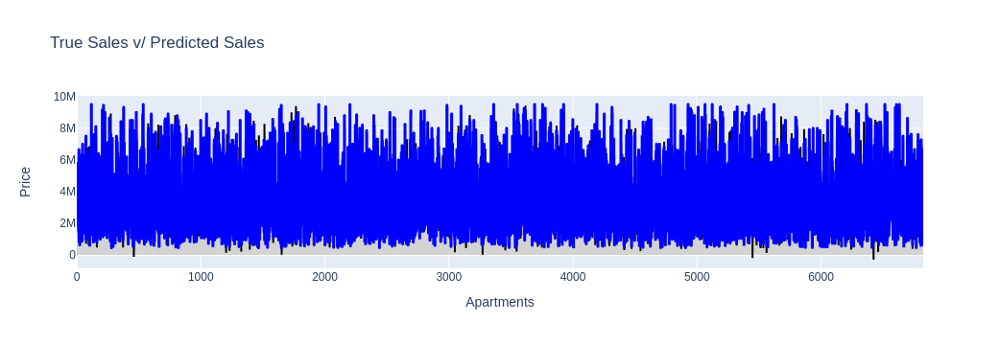

In [62]:
(p
 .plot(kind="line", y="actual_price", title=f"True Sales v/ Predicted Sales", )
 .update_traces(line = dict(color = 'blue', width=3))
 
  .update_layout(hovermode="x unified", 
                 xaxis_title="Apartments",
                yaxis_title="Price",)

  # .add_traces(p.plot(kind="line", y="predicted_price")
  #            .update_traces(line = dict(color = 'black', width=2)
  #                                                                  ).data
  #           )
 .add_traces(p.plot(kind="area", y="predicted_price")
             .update_traces( 
                            line= dict(color = 'black', width=2),
                            fill='tonexty',
                            fillcolor="lightgrey",
                            
                                                 ).data
            )
 
)


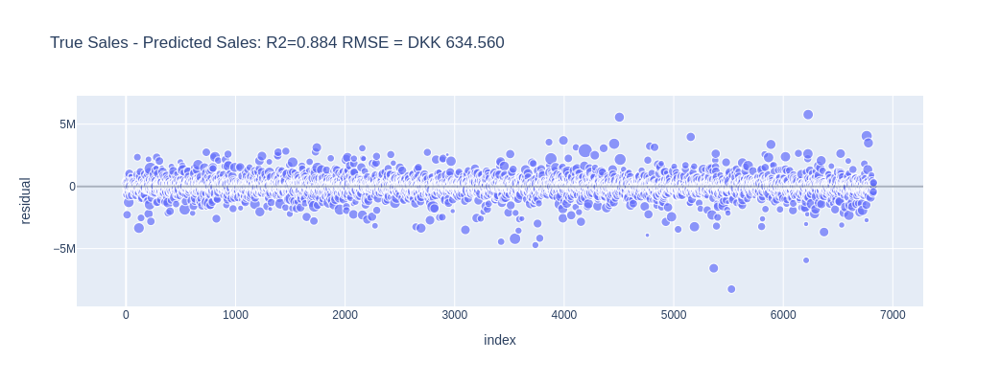

In [63]:
fig_size = {"width":1200, "height":400}
R2 = predictor.score(X_test, y_test).round(3)
RMSE = f"{int(mean_squared_error(y_true=y_test, y_pred=predicted_price, squared=False)):,}".replace(",",".")

(   p.plot(kind="scatter",
           y="residual",
           x=p.index,
           size="size",
           size_max=15,
           title=f"True Sales - Predicted Sales: {R2=} RMSE = DKK {RMSE}",
           **fig_size
          )
     .add_hline(y=0, opacity=0.4, )
     .update_traces(mode="markers")
     .update_layout(hovermode="y")
)

In [64]:
p.assign(residual = lambda d: abs(d["residual"])).sort_values("residual").reset_index(drop=True).iloc[-30:]

,size,latitude,longitude,rooms,buildYear,soldYear,actual_price,predicted_price,residual,under_estimate
6795,108.0,55.700726,12.577149,4,1970,2020,2250000.0,5392866,3142866.0,False
6796,68.0,55.687138,12.540910,2,1893,2015,7300000.0,4132508,3167492.0,True
6797,103.0,55.689373,12.521725,3,1929,2021,8750000.0,5558660,3191340.0,True
6798,98.0,55.685757,12.596992,2,1778,2020,8500000.0,5269982,3230018.0,True
6799,107.0,55.691300,12.472754,3,1935,2018,1095000.0,4328978,3233978.0,False
6800,156.0,55.690308,12.577023,5,1882,2018,9350000.0,6105600,3244400.0,True
6801,100.0,55.679676,12.568276,3,2002,2017,8250000.0,4994548,3255452.0,True
6802,174.0,55.672432,12.533810,4,1934,2015,9500000.0,6148483,3351517.0,True
6803,146.0,55.665314,12.622104,5,2015,2019,9100000.0,5741900,3358100.0,True
6804,150.0,55.668150,12.578806,5,1907,2016,2531056.0,5900809,3369753.0,False


In [65]:
interesting_columns = [
    'actual_price', 'predicted_price',  'residual', 'under_estimate',
    'size', 'rooms', 'longitude', 'latitude', 'buildYear',
    'soldYear'
      
]

In [66]:
vis = hip.Experiment.from_dataframe(p[interesting_columns])
vis.display()

<IPython.core.display.Javascript object>

In [67]:
p.shape

(6825, 10)

# Model Agnostics

In [68]:
train_data = pd.DataFrame(X_train, columns=X_.design_info.column_names).assign(price=y_train)
test_data = pd.DataFrame(X_test, columns=X_.design_info.column_names).assign(price=y_test)

In [69]:
category_features = train_data.columns[train_data.columns.str.startswith("C")]

In [70]:
from deepchecks.tabular import Dataset

In [71]:
ds_train = Dataset(train_data.iloc[:, :-1], label=train_data["price"], cat_features=[])
ds_test = Dataset(test_data.iloc[:, :-1], label=test_data["price"], cat_features=[])

In [72]:
predictor.model

LGBMRegressor(colsample_bytree=0.5805150806812911,
              learning_rate=0.040464524134700836, max_bin=1023,
              min_child_samples=9, n_estimators=2337, num_leaves=267,
              reg_alpha=0.023296498194689437, reg_lambda=0.01198109649328531,
              verbose=-1)

In [73]:
import warnings
from pandas.errors import PerformanceWarning
warnings.simplefilter(action='ignore', category=PerformanceWarning)

In [76]:
from deepchecks.tabular.suites import model_evaluation

In [77]:
suite = model_evaluation()
suite.run(train_dataset=ds_train, test_dataset=ds_test, model=predictor.model,)

IndexError: list assignment index out of range

IndexError: list assignment index out of range

IndexError: list assignment index out of range

Model Evaluation Suite

In [79]:
suite_results

IndexError: list assignment index out of range

IndexError: list assignment index out of range

IndexError: list assignment index out of range

Model Evaluation Suite